In [28]:
# mounting the drive to get the dataset
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [29]:
# importing libraries
import cv2 as cv
from google.colab.patches import cv2_imshow
import numpy as np
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")

## Draw a bounding box around the foreground object

In [30]:
# getting the dataset(csv file) and converting into pandas dataframe
path_link = "/content/drive/MyDrive/Colab_Notebooks/IIITB_VR/InputUngradedAssignment1.jpg"

# LOAD AN IMAGE USING 'IMREAD'
img = cv.imread(path_link)

# convert the image to grayscale
gray = cv.cvtColor(img, cv.COLOR_BGRA2GRAY)

# apply thresholding on the gray image to create a binary image
ret, thresh = cv.threshold(gray, 127,255,0)

In [31]:
height, width, channels = img.shape
print(height)
print(width)
print(channels)

2136
4624
3


In [32]:
# find the contours
contours, hierarchy = cv.findContours(thresh, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)

## Initial Finding while creating a bounding box around the foreground Object.

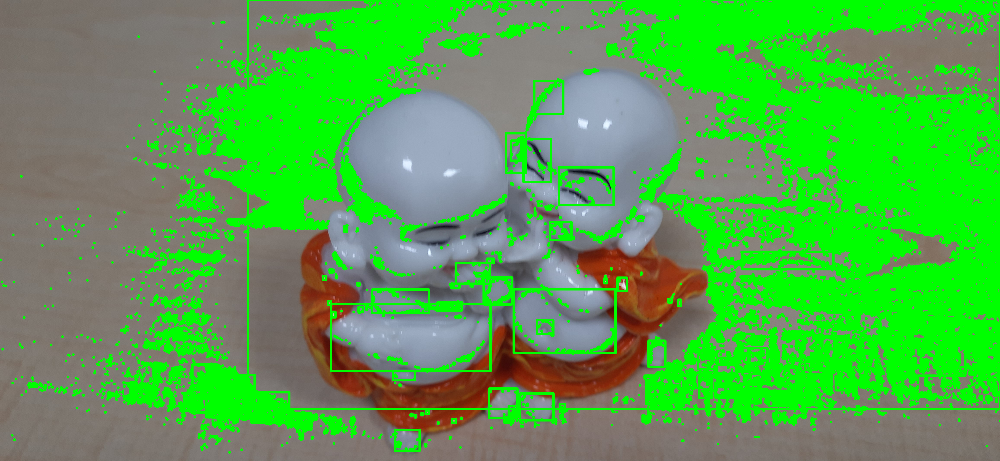

In [33]:
img_bounding_box_initial = img

for i in range(len(contours)):
    cnt = contours[i]

    x,y,w,h = cv.boundingRect(cnt)
    # print(x,y,w,h)

    # draw the bounding rectangle
    img_bounding_box_initial = cv.rectangle(img_bounding_box_initial, (x,y),(x+w,y+h),(0,255,0),10)

cv2_imshow(img_bounding_box_initial)

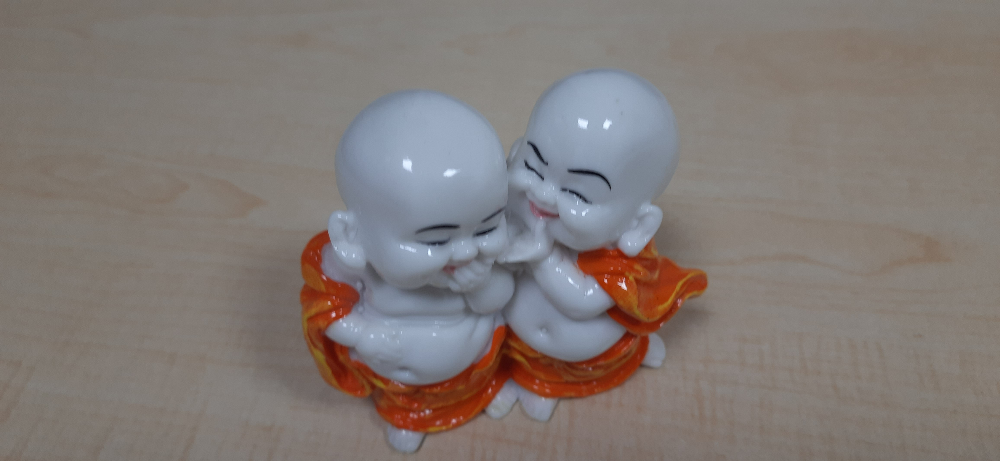

In [34]:
# getting the dataset(csv file) and converting into pandas dataframe
path_link = "/content/drive/MyDrive/Colab_Notebooks/IIITB_VR/InputUngradedAssignment1.jpg"

# LOAD AN IMAGE USING 'IMREAD'
img = cv.imread(path_link)

# DISPLAY
cv2_imshow(img)

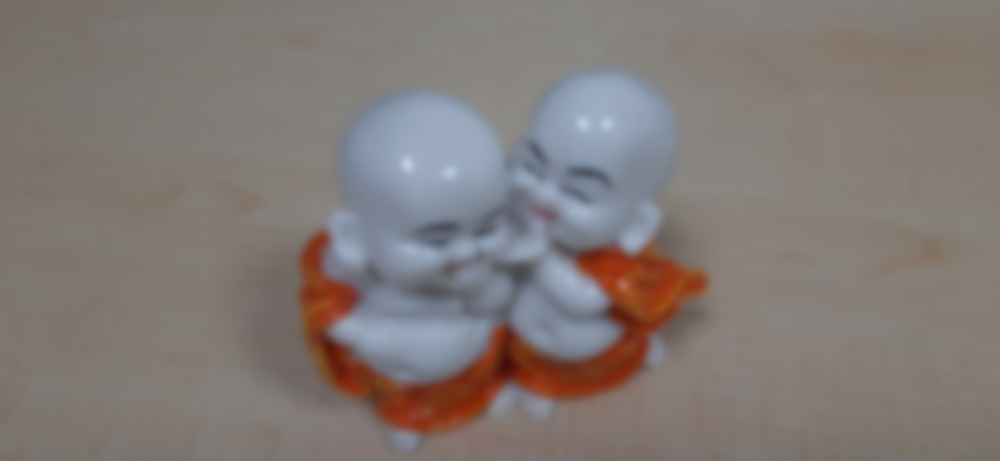

In [35]:
# Blur image using Gaussian Blur method
blur_img = cv.GaussianBlur(img,(121,121),0)

cv2_imshow(blur_img)

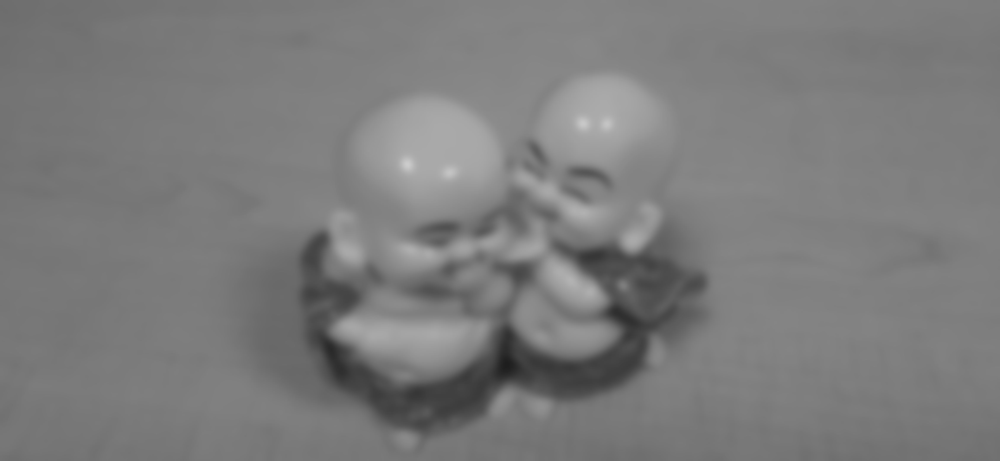

In [36]:
# convert the image to grayscale
gray = cv.cvtColor(blur_img, cv.COLOR_BGRA2GRAY)

# DISPLAY
cv2_imshow(gray)

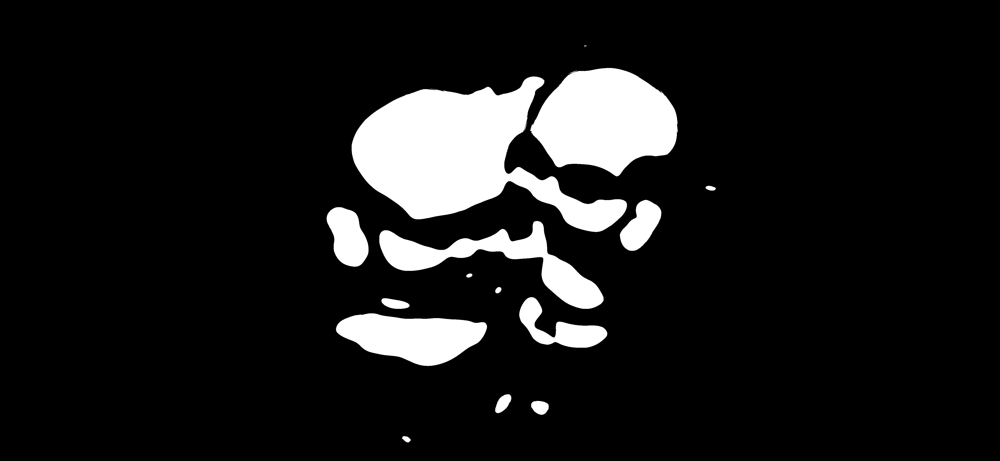

In [37]:
# apply thresholding on the gray image to create a binary image
ret, thresh = cv.threshold(gray, 135,255,0)

cv2_imshow(thresh)

In [38]:
# find the contours
contours, hierarchy = cv.findContours(thresh, cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)

## Final Finding while creating a bounding box around the foreground Object after adding Guassian Blur to the image and changing some hyperparameters.



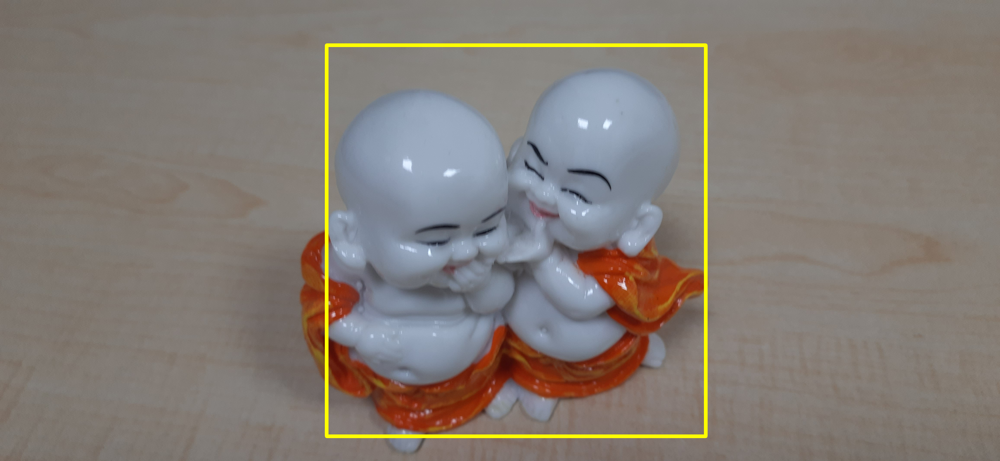

In [39]:
img_bounding_box = img

min_x = img.shape[0]
min_y = img.shape[1]
max_x = 0
max_y = 0

height = 20
width = 20

for i in range(len(contours)):
    cnt = contours[i]

    x,y,w,h = cv.boundingRect(cnt)
    # print(x,y,w,h)

    if(x<min_x):
        min_x = x
    if(y<min_y):
        min_y = y
    if(x>max_x):
        max_x = x
    if(y>max_y):
        max_y = y

    height =  max_y - min_y
    width = max_x - min_x

x = min_x
y = min_y

# draw the bounding rectangle
img_bounding_box = cv.rectangle(img_bounding_box, (x,y),(x+width,y+height),(0,255,255),15)

cv2_imshow(img_bounding_box)

## Conversion of image into gray-scale and Detection of edges using Canny edge detection method

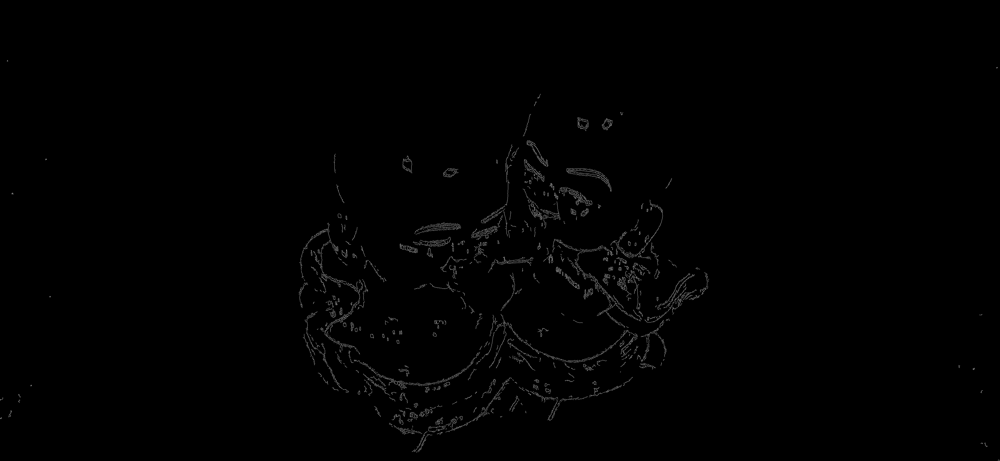

In [40]:
# LOAD AN IMAGE USING 'IMREAD'
img = cv.imread(path_link)

# Blur image with Gaussian Blurring method
blur_img = cv.GaussianBlur(img,(5,5),0)

# cv2_imshow(blur_img)

# convert the image to grayscale
gray_canny = cv.cvtColor(blur_img, cv.COLOR_BGR2GRAY)

# Applying Canny edge detection method on gray-scale image
edged= cv.Canny(gray_canny,30,10)

cv2_imshow(edged)

## Use K-means for segmentation on the RGB image, and display the segmented region


In [41]:
def preprocess_image(image):
    # Convert the image into RGB
    image = cv.cvtColor(image, cv.COLOR_BGR2RGB)

    # Reshape the image into a 2D array of pixels and 3 colour values (RGB)
    pixel_values = image.reshape((-1,3))

    # Convert the pixel values into float
    return np.float32(pixel_values)

In [42]:
def perform_kmeans_clustering(pixel_values, k=3):
    # Perform k-means clustering on the pixels values
    criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 100, 0.2)
    compactness, lables, centers = cv.kmeans(pixel_values, k, None, criteria, 10, cv.KMEANS_RANDOM_CENTERS)
    return compactness, lables, np.uint8(centers)

In [43]:
def create_segmented_image(pixel_values, labels, centers, image):
    # Create a segmented image using the cluster centroids
    segmented_image = centers[labels.flatten()]
    return segmented_image.reshape(image.shape)

In [44]:
def create_masked_image(image, labels, cluster_to_disable):
    # Create a masked image by disabling a specific cluster
    masked_image = np.copy(image).reshape((-1,3))
    masked_image[labels.flatten() == cluster_to_disable] = [0,0,0]
    return masked_image.reshape(image.shape)

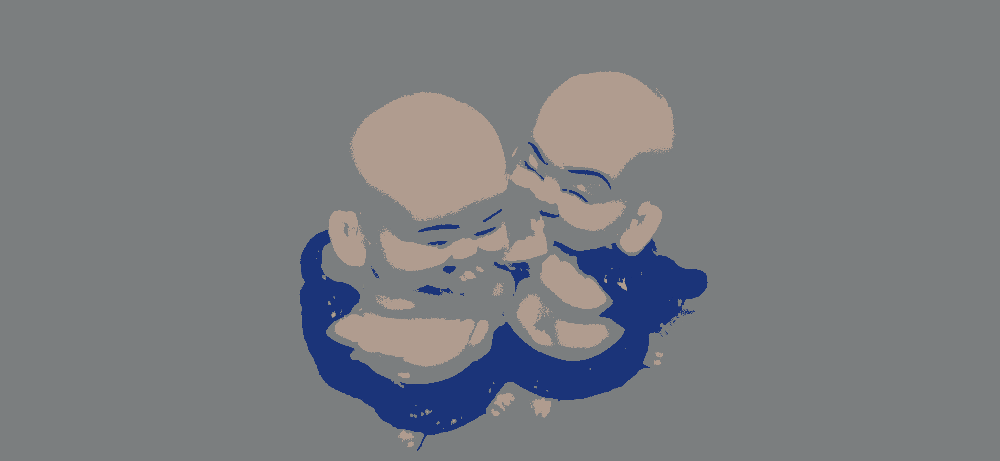

In [45]:
# LOAD AN IMAGE USING 'IMREAD'
img = cv.imread(path_link)

# preprocess the image
pixel_values = preprocess_image(img)

# compactness is the sum of squared distance from each point to their corresponding centers
compactness, labels, centers = perform_kmeans_clustering(pixel_values,3)

# create the segmented image
segmented_image = create_segmented_image(pixel_values, labels, centers, img)

# display the image
cv2_imshow(segmented_image)

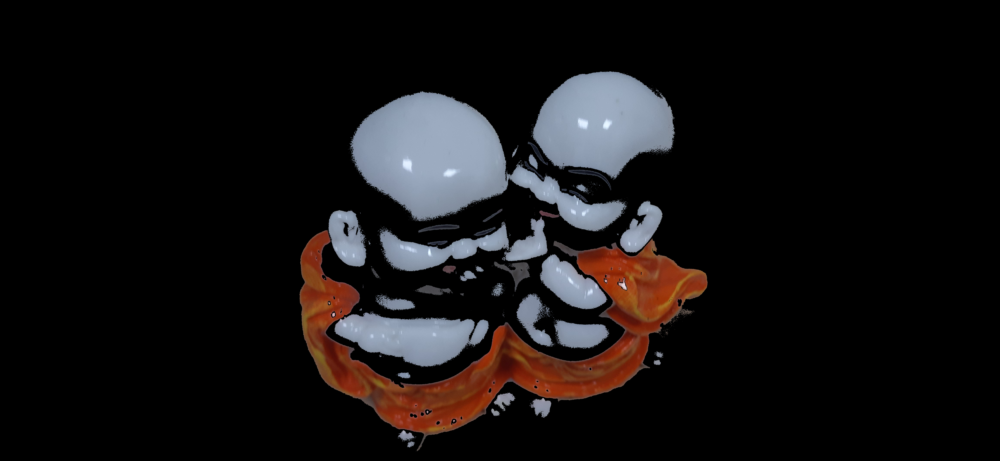

In [52]:
# disable only the cluster number 2 (turn the pixel into black)
cluster_to_disable = 1

# create the masked image
masked_image = create_masked_image(img, labels, cluster_to_disable)
cv2_imshow(masked_image)

In [47]:
cv.imwrite("/content/drive/MyDrive/Colab_Notebooks/IIITB_VR/segmented_image.jpg",segmented_image)

True

In [53]:
cv.imwrite("/content/drive/MyDrive/Colab_Notebooks/IIITB_VR/masked_image.jpg",masked_image)

True

In [49]:
cv.imwrite("/content/drive/MyDrive/Colab_Notebooks/IIITB_VR/image_with_bounding_box.jpg",img_bounding_box)

True

In [50]:
cv.imwrite("/content/drive/MyDrive/Colab_Notebooks/IIITB_VR/grayscale_image.jpg",gray_canny)

True

In [51]:
cv.imwrite("/content/drive/MyDrive/Colab_Notebooks/IIITB_VR/img_with_bounding_box_initial.jpg",img_bounding_box_initial)

True